In [1]:
%config Completer.use_jedi = False
import scanpy as sc
import pandas as pd
sc.set_figure_params(dpi = 120)
from matplotlib import pyplot as plt
import seaborn as sns
import os

import matplotlib.pyplot as plt

# create a color dictionary for tissues
def tissue_colors():
    
    tissue_color_dict = {'Bladder': '#e7969c',
             'Blood': '#d6616b',
             'Bone_Marrow': '#cedb9c',
             'Eye': '#c7ea46',#"#00ff7f",
             'Fat': '#e7cb94',
             'Heart': '#ff0800',
             'Kidney': '#7b4173',
             'Large_Intestine': '#31a354',
             'Liver': '#000080',
             'Lung': '#3182bd',
             'Lymph_Node': '#8c6d31',
             'Mammary':'#ce6dbd',
             'Muscle': '#e7ba52',
             'Pancreas': '#fd8d3c',
             'Prostate':'#637939',#'#a55194',#
             'Salivary_Gland':'#622a0f',
             'Skin': '#de9ed6',
             'Small_Intestine': '#6baed6',
             'Spleen': '#393b79',
             'Thymus': '#9c9ede',
             'Tongue':'#b5cf6b',
             'Trachea': '#969696',
             'Uterus':'#c64b8c',#'#ff0090',
             'Vasculature': '#843c39'}
    
    return tissue_color_dict



def _pp(adata, log, normalize, remove_dissociation):
    if normalize:
        sc.pp.normalize_total(adata)
    if log:
        sc.pp.log1p(adata, chunk_size=50000)
        adata.raw = adata 

    if remove_dissociation:
    #mouse2human = pd.read_csv('../metadata/mouse2human.csv')
        dissociation_genes = pd.read_csv('../metadata/Mouse2Human_dissociation_genes.csv')
        adata.var['not_dissociation_gene'] = ~adata.var.index.isin(dissociation_genes['Human gene name'])
        adata = adata[:, adata.var.not_dissociation_gene == True]
    return adata







In [2]:
tissue_colors = tissue_colors()


cell_label = 'cell_ontology_class'


# cannot currently read this object because it kills my kernel
adata = sc.read_h5ad('../data/h5ads/TSP1_TSP15_scvi_donor-method_normalized-log1p-scaled_annotated.h5ad', backed='r+')

# subset to circulating cell types
cell_types_in_Blood = adata.obs.groupby('tissue')[cell_label].value_counts().xs('Blood')
circulating_cell_types = cell_types_in_Blood[cell_types_in_Blood > 30]

adata = adata[adata.obs.cell_ontology_class.isin(circulating_cell_types.index)]


adata = adata.to_memory()


adata = _pp(adata, True, True, False)

# filter out tissue defining genes as sources of ambient RNA noise or doublets
sc.tl.rank_genes_groups(adata, groupby='tissue')

sc.tl.filter_rank_genes_groups(adata, min_fold_change=1)

result = _sub_adata.uns['rank_genes_groups_filtered']
groups = result['names'].dtype.names
gene_df = pd.DataFrame(
    {group + '_' + key[:]: result[key][group]
     # Get Each Clusters 10 top Genes
    for group in groups for key in ['names', 'pvals']})

x = result['names']

# flattening wasn't working
genes = []
for i in x:
    for gene in i:
        genes.append(gene)

tissue_genes = pd.Series(genes)

tissue_genes = tissue_genes.dropna().drop_duplicates()

adata = adata[:,~adata.var.index.isin(tissue_genes)]

In [3]:
adata.obs.cell_ontology_class.value_counts()

macrophage                                                     36875
memory b cell                                                  15749
neutrophil                                                     15091
classical monocyte                                             14141
cd4-positive, alpha-beta t cell                                14077
monocyte                                                       12524
cd8-positive, alpha-beta t cell                                12493
plasma cell                                                    11593
erythrocyte                                                    11021
nk cell                                                         9037
naive b cell                                                    6818
type i nk t cell                                                5314
cd4-positive, alpha-beta memory t cell                          4540
naive thymus-derived cd4-positive, alpha-beta t cell            3264
cd8-positive, alpha-beta cytokine 

In [4]:
# start iterating through the cell types 
cell_type = 'macrophage'

_sub_adata = adata[adata.obs.cell_ontology_class == cell_type]

In [5]:
label = 'tissue'

In [6]:
# subset to tissues with more than 10 members of this particular cell class
_df = pd.DataFrame(_sub_adata.obs.groupby(label)[cell_label].value_counts() > 10)

_tissues = _df[_df.cell_ontology_class == True].unstack().index.to_list()

_sub_adata = _sub_adata[_sub_adata.obs.tissue.isin(_tissues)]

In [7]:
_tissues

['Bladder',
 'Blood',
 'Bone_Marrow',
 'Eye',
 'Fat',
 'Heart',
 'Kidney',
 'Liver',
 'Lung',
 'Lymph_Node',
 'Mammary',
 'Muscle',
 'Prostate',
 'Salivary_Gland',
 'Skin',
 'Spleen',
 'Thymus',
 'Trachea',
 'Uterus',
 'Vasculature']

In [8]:
sc.tl.rank_genes_groups(_sub_adata, groupby=label, method='wilcoxon')

sc.tl.filter_rank_genes_groups(_sub_adata, min_fold_change=0.5)

Trying to set attribute `.uns` of view, copying.


/home/michaelswift/miniconda3/envs/scirpy/lib/python3.8/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


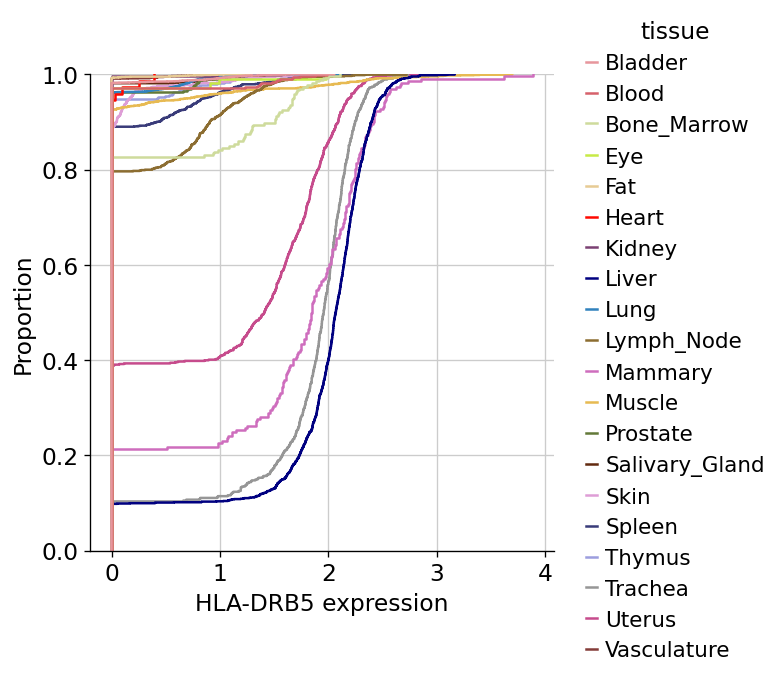

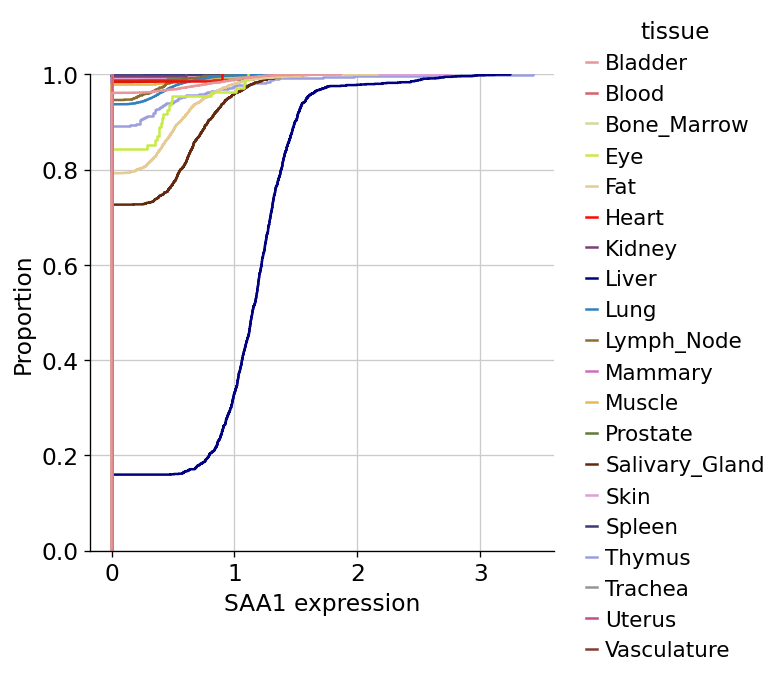

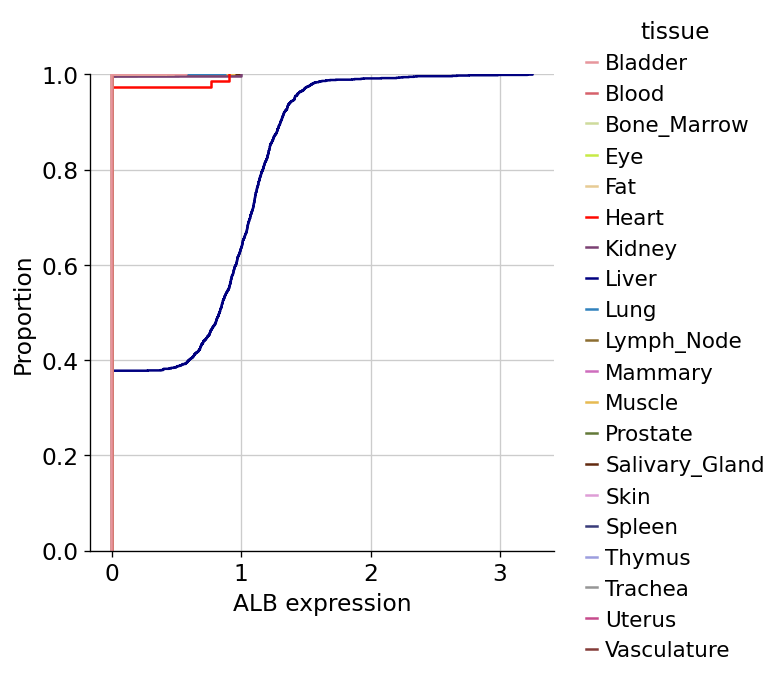

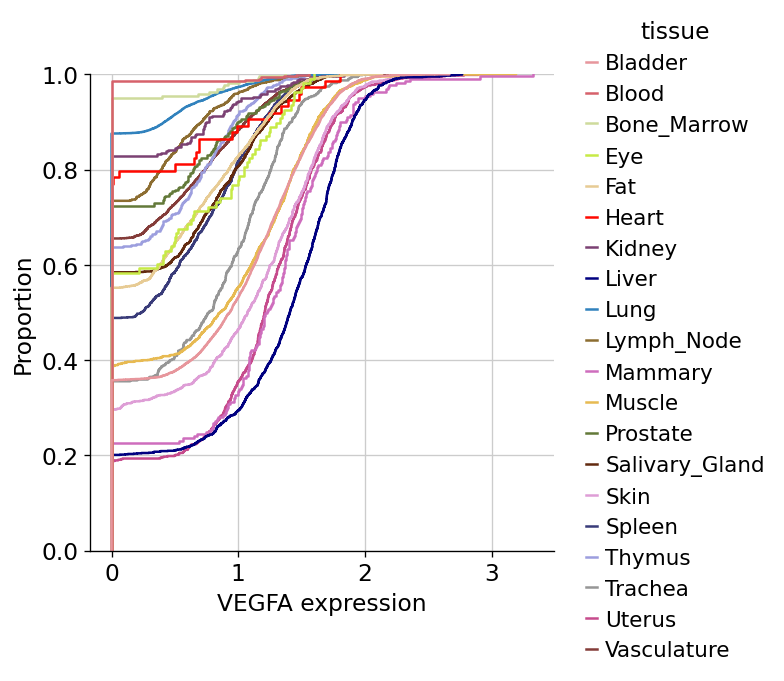

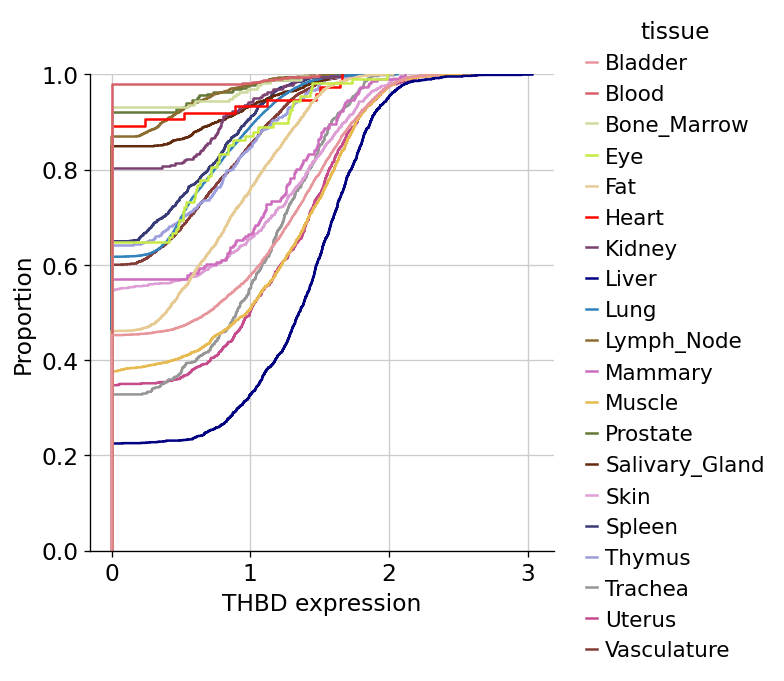

...

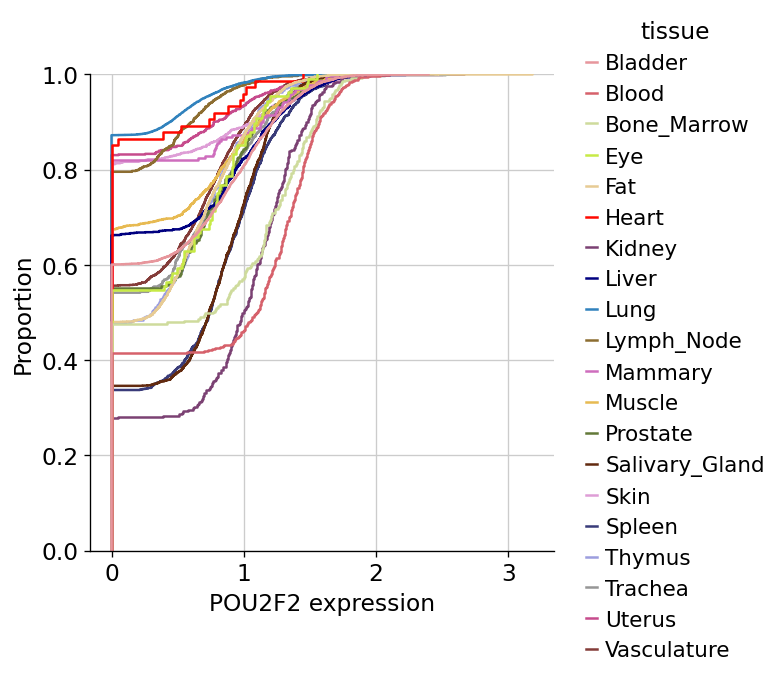

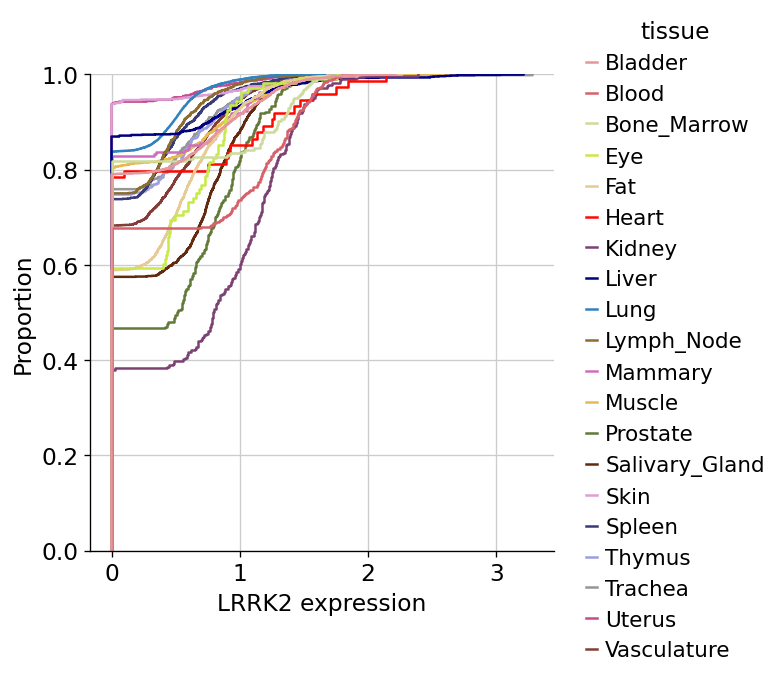

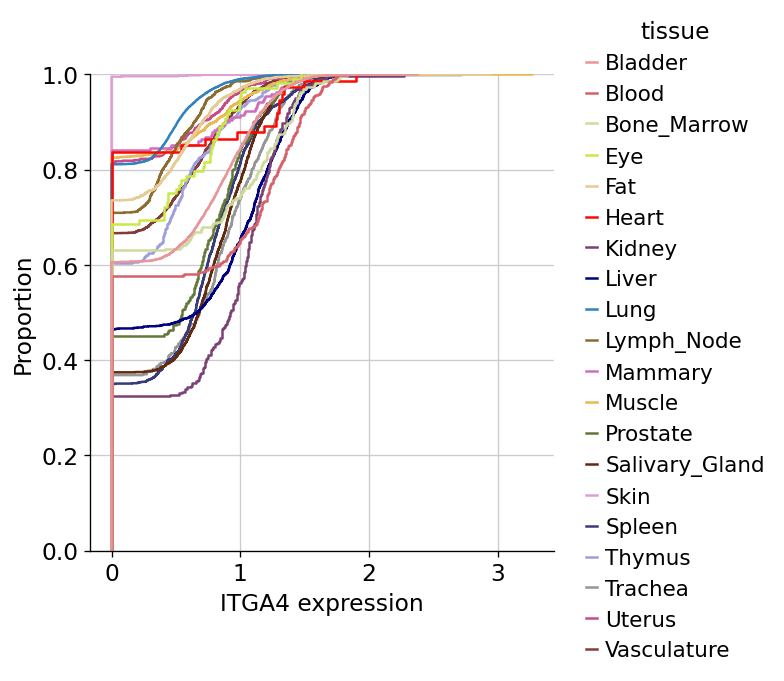

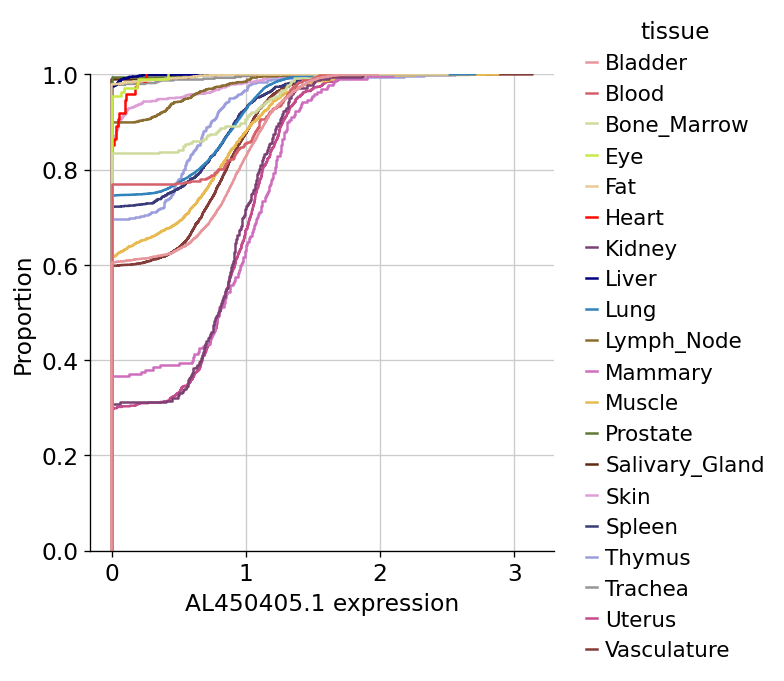

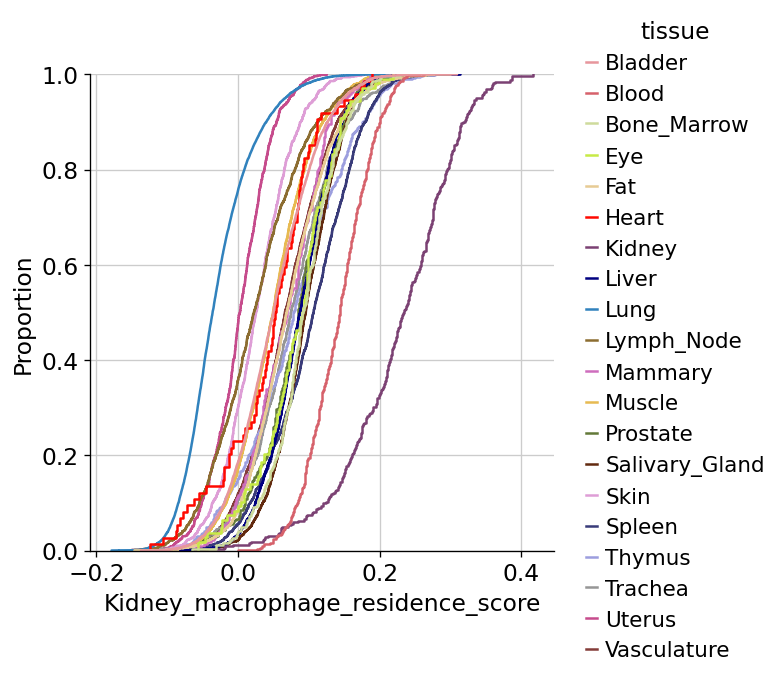

In [9]:
holo_gene_set = []
result = _sub_adata.uns['rank_genes_groups_filtered']
groups = result['names'].dtype.names
gene_df = pd.DataFrame(
    {group + '_' + key[:]: result[key][group]
     # Get Each Clusters 10 top Genes
    for group in groups for key in ['names', 'pvals']})


#iterate thru the unique tissues
for tis in _sub_adata.obs[label].unique():

    # reset rank genes df for new organ
    _gene_df = gene_df.copy()
     # Drop the filtered genes
    _gene_df = _gene_df[[tis + '_names', tis + '_pvals']].dropna()
    gene_list = _gene_df[tis + '_names'].to_list()
    genes = gene_list
    holo_gene_set.append(gene_list)
    score_name = tis + '_' + cell_type + "_residence_score"
    sc.tl.score_genes(_sub_adata, gene_list = gene_list, score_name = score_name, use_raw = False)
    plotdf = sc.get.obs_df(
            _sub_adata,
            keys=genes +[label, score_name])
    for gene in genes[:10]:
        g = sns.displot(data = plotdf, x = gene, hue = label, kind='ecdf', palette=tissue_colors
                       )
        g.set_titles(cell_type)
        g.set_xlabels(gene + ' expression')
        directory = 'figures/label_Residency/{}_{}/'.format(cell_type, tis)
        if not os.path.exists(directory):
            os.makedirs(directory)
        g.savefig('figures/label_Residency/{}_{}/{}.png'.format(cell_type, tis, gene))
    g = sns.displot(data = plotdf, x=score_name, hue = label, kind = 'ecdf', palette=tissue_colors)
    g.savefig('figures/label_Residency/{}'.format(score_name))

In [10]:
flat_list = [item for sublist in holo_gene_set for item in sublist]

In [11]:
flat_list

['HLA-DRB5',
 'SAA1',
 'ALB',
 'VEGFA',
 'THBD',
 'SDS',
 'SERPINB9',
 'BASP1',
 'MXD1',
 'RPS4Y1',
 'PTGS2',
 'FPR3',
 'HLA-DQB1',
 'EREG',
 'ARL4C',
 'INSIG1',
 'SATB1',
 'NR4A3',
 'CD93',
 'OSM',
 'RASSF5',
 'HES1',
 'PFKFB3',
 'ADGRE2',
 'G0S2',
 'PDE4B',
 'TNFSF13B',
 'PPIF',
 'GK',
 'CD300E',
 'HES4',
 'CD48',
 'NLRP3',
 'DDIT4',
 'ABCA1',
 'MEF2C',
 'DDX3Y',
 'TTYH3',
 'ITGA4',
 'NRARP',
 'VCAN',
 'PRDM1',
 'TET2',
 'PRKCB',
 'OTUD1',
 'DUSP2',
 'LILRB1',
 'MT-ND6',
 'FAM49A',
 'LPCAT1',
 'IL10',
 'AC104695.4',
 'SDC3',
 'RB1',
 'MTND5P32',
 'HPS3',
 'PAPSS2',
 'HPD',
 'RGS1',
 'MALT1',
 'CR1',
 'TENT4B',
 'C9orf72',
 'AC016831.5',
 'SLC7A5',
 'SLC16A10',
 'SEC14L1',
 'LUCAT1',
 'APOC3',
 'NUP58',
 'PEA15',
 'STAB1',
 'CHST15',
 'HPSE',
 'NBEAL1',
 'FGL1',
 'USP36',
 'CSF3R',
 'HLA-DQA1',
 'RN7SL368P',
 'AREG',
 'CD36',
 'RF00017-71',
 'AC037198.1',
 'LILRA5',
 'SLC25A37',
 'NDEL1',
 'IFNAR2',
 'LILRB2',
 'RXRA',
 'MT1G',
 'SLC8A1',
 'ETV3',
 'RUNX3',
 'RNASE2',
 'PRCP',
 'THAP9

In [19]:
pd.DataFrame(flat_list).to_csv(cell_type + "tissue_distinguishing_genes.csv")

In [12]:
## Re load the data 

In [13]:
# cannot currently read this object because it kills my kernel
adata = sc.read_h5ad('../data/h5ads/TSP1_TSP15_scvi_donor-method_normalized-log1p-scaled_annotated.h5ad', backed='r+')

adata = adata[adata.obs.cell_ontology_class == cell_type]

adata = adata.to_memory()
adata = adata[~adata.obs.tissue.isin(['Salivary_Gland', 'Heart', 'Eye'])]
kmeans = True

if kmeans:
    adata = adata[:,adata.var.index.isin(flat_list)]

def _pp(adata, log, normalize, remove_dissociation):
    if normalize:
        sc.pp.normalize_total(adata)
    if log:
        sc.pp.log1p(adata, chunk_size=50000)
        adata.raw = adata 

    if remove_dissociation:
    #mouse2human = pd.read_csv('../metadata/mouse2human.csv')
        dissociation_genes = pd.read_csv('../metadata/Mouse2Human_dissociation_genes.csv')
        adata.var['not_dissociation_gene'] = ~adata.var.index.isin(dissociation_genes['Human gene name'])
        adata = adata[:, adata.var.not_dissociation_gene == True]
    return adata

adata = _pp(adata, True, True, False)

/home/michaelswift/miniconda3/envs/scirpy/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


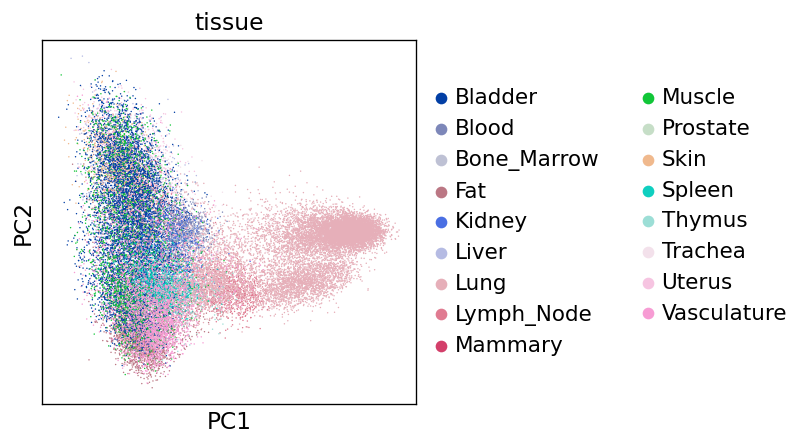

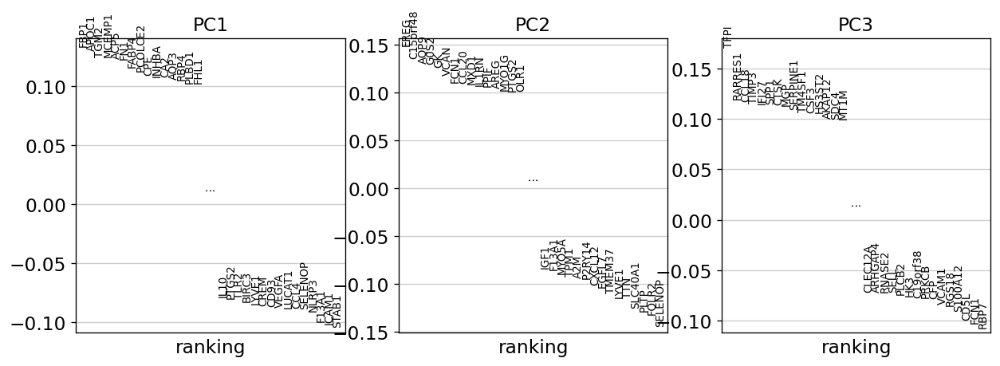

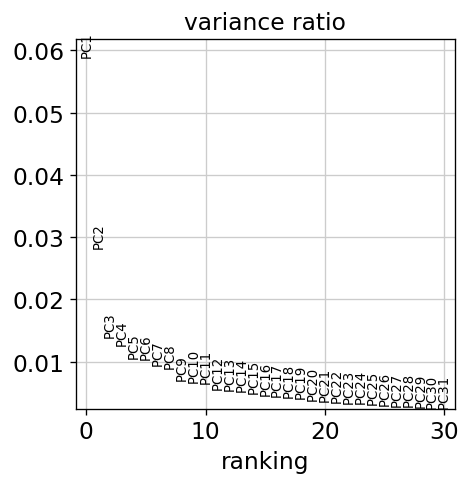

In [14]:
sc.pp.scale(adata)

sc.pp.pca(adata)

sc.pl.pca_overview(adata, color = ['tissue'], projection = '2d', size = 3)

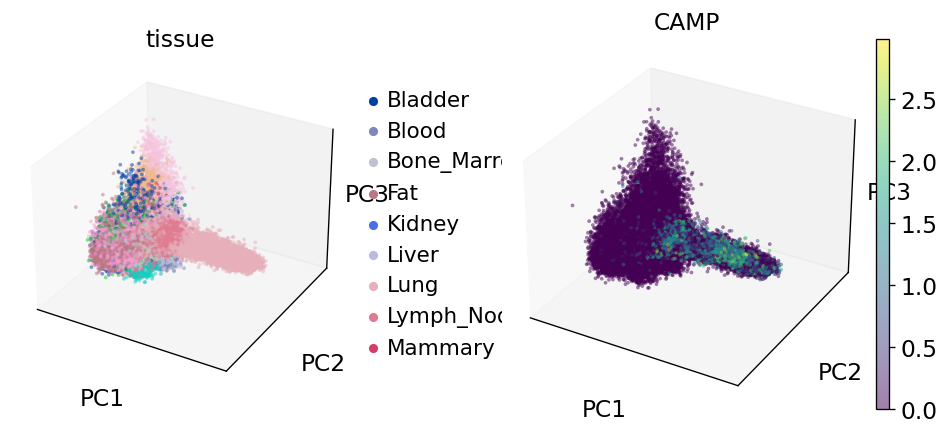

In [15]:
sc.pl.pca(adata, color = ['tissue', 'CAMP'], add_outline=False, projection = '3d', size=60, alpha = 0.5)

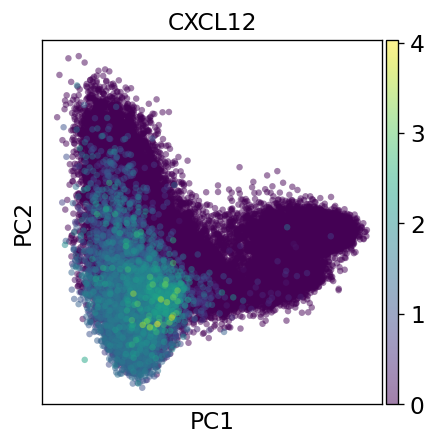

In [35]:
sc.pl.pca(adata, color = ['CXCL12'], add_outline=False, projection = '2d', size=60, alpha = 0.5)

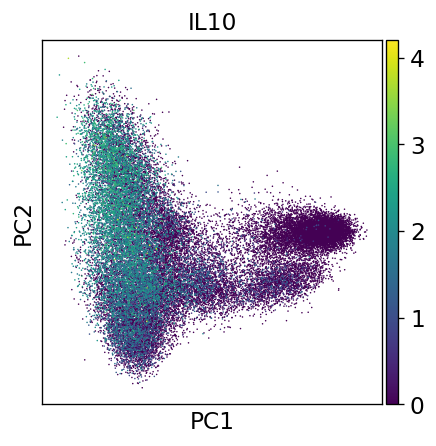

In [34]:
sc.pl.pca(adata, color = ['IL10'], add_outline=False, projection = '2d')

In [36]:
tissue_colors

{'Bladder': '#e7969c',
 'Blood': '#d6616b',
 'Bone_Marrow': '#cedb9c',
 'Eye': '#c7ea46',
 'Fat': '#e7cb94',
 'Heart': '#ff0800',
 'Kidney': '#7b4173',
 'Large_Intestine': '#31a354',
 'Liver': '#000080',
 'Lung': '#3182bd',
 'Lymph_Node': '#8c6d31',
 'Mammary': '#ce6dbd',
 'Muscle': '#e7ba52',
 'Pancreas': '#fd8d3c',
 'Prostate': '#637939',
 'Salivary_Gland': '#622a0f',
 'Skin': '#de9ed6',
 'Small_Intestine': '#6baed6',
 'Spleen': '#393b79',
 'Thymus': '#9c9ede',
 'Tongue': '#b5cf6b',
 'Trachea': '#969696',
 'Uterus': '#c64b8c',
 'Vasculature': '#843c39'}

In [38]:
sc.pl.pca(adata, color = ['tissue'], add_outline=False, projection = '2d', size=5, save=
'macrophage_tissue', )

ValueError: {'Bladder': '#e7969c', 'Blood': '#d6616b', 'Bone_Marrow': '#cedb9c', 'Eye': '#c7ea46', 'Fat': '#e7cb94', 'Heart': '#ff0800', 'Kidney': '#7b4173', 'Large_Intestine': '#31a354', 'Liver': '#000080', 'Lung': '#3182bd', 'Lymph_Node': '#8c6d31', 'Mammary': '#ce6dbd', 'Muscle': '#e7ba52', 'Pancreas': '#fd8d3c', 'Prostate': '#637939', 'Salivary_Gland': '#622a0f', 'Skin': '#de9ed6', 'Small_Intestine': '#6baed6', 'Spleen': '#393b79', 'Thymus': '#9c9ede', 'Tongue': '#b5cf6b', 'Trachea': '#969696', 'Uterus': '#c64b8c', 'Vasculature': '#843c39'} is not a valid value for name; supported values are 'Accent', 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 'CMRmap', 'CMRmap_r', 'Dark2', 'Dark2_r', 'GnBu', 'GnBu_r', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 'OrRd', 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 'Pastel1', 'Pastel1_r', 'Pastel2', 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 'PuBu_r', 'PuOr', 'PuOr_r', 'PuRd', 'PuRd_r', 'Purples', 'Purples_r', 'RdBu', 'RdBu_r', 'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r', 'RdYlGn', 'RdYlGn_r', 'Reds', 'Reds_r', 'Set1', 'Set1_r', 'Set2', 'Set2_r', 'Set3', 'Set3_r', 'Spectral', 'Spectral_r', 'Wistia', 'Wistia_r', 'YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 'YlOrBr_r', 'YlOrRd', 'YlOrRd_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 'cividis', 'cividis_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r', 'crest', 'crest_r', 'cubehelix', 'cubehelix_r', 'flag', 'flag_r', 'flare', 'flare_r', 'gist_earth', 'gist_earth_r', 'gist_gray', 'gist_gray_r', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r', 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 'gist_yarg', 'gist_yarg_r', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r', 'hot', 'hot_r', 'hsv', 'hsv_r', 'icefire', 'icefire_r', 'inferno', 'inferno_r', 'jet', 'jet_r', 'magma', 'magma_r', 'mako', 'mako_r', 'nipy_spectral', 'nipy_spectral_r', 'ocean', 'ocean_r', 'pink', 'pink_r', 'plasma', 'plasma_r', 'prism', 'prism_r', 'rainbow', 'rainbow_r', 'rocket', 'rocket_r', 'seismic', 'seismic_r', 'spring', 'spring_r', 'summer', 'summer_r', 'tab10', 'tab10_r', 'tab20', 'tab20_r', 'tab20b', 'tab20b_r', 'tab20c', 'tab20c_r', 'terrain', 'terrain_r', 'turbo', 'turbo_r', 'twilight', 'twilight_r', 'twilight_shifted', 'twilight_shifted_r', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r'

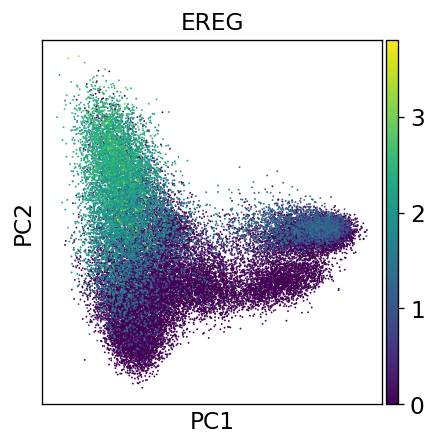

In [27]:
sc.pl.pca(adata, color = ['EREG'], add_outline=False, projection = '2d', size=5, save = 'macrophage_EREG')

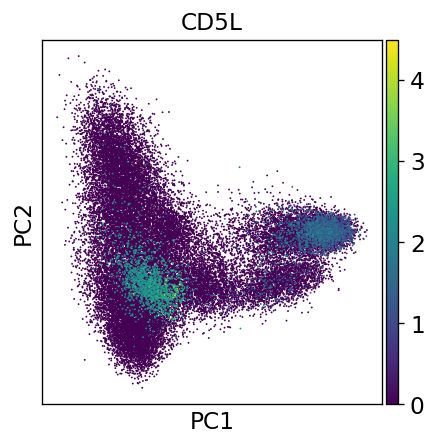

In [31]:
gene = "CD5L"
sc.pl.pca(adata, color = gene, add_outline=False, projection = '2d', size=5, save = 'macrophage'+gene)

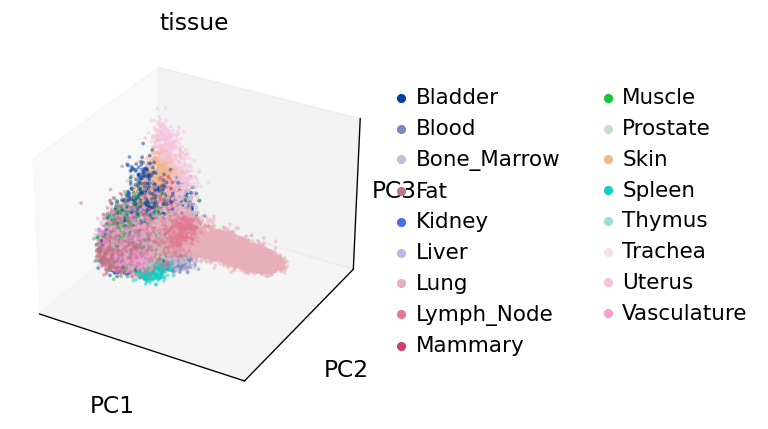

In [18]:
sc.pl.pca(adata, color = ['tissue'], add_outline=False, projection = '3d', size=60, alpha = 0.5)

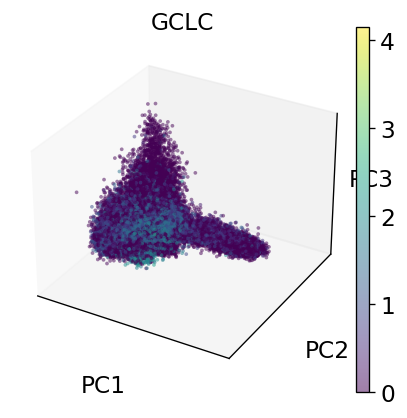

In [28]:
sc.pl.pca(adata, color = ['GCLC'], add_outline=False, projection = '3d', size=60, alpha = 0.5)